# Finding a 2D mixed-mode SSM from video footage of an inverted flag

In this notebook we investigate a fluid - structure interaction problem. A flexible sheet, the flag, is placed in a water tunnel. The trailing edge (with respect to the flow direction) is clamped. 

Video footage is recorded of the oscillatory dynamics of the flag, which we call flapping. 


The experiment and the reduced-order modeling method is described in the following manuscript


Z. Xu, B. Kaszás, M. Cenedese, G. Berti, F. Coletti, G. Haller, Data-driven modeling of the regular and chaotic dynamics of an inverted flag from experiments, J. Fluid Mech. 987 (2024)

The position of the tip of the flag is recorded from the video footage and is stored in the folder 'data'. In total, 19 experiments were performed. 



## Loading the data 

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import loadmat

The trajectories are stored in text files with two columns ```(time, displacement)``` in the ```data``` folder. We read them and store them in a list. Each element of the array ```xData``` is a list of two elements, corresponding to time and displacement. 
The time array has shape ```(1, n_snapshots)``` and the displacement has the shape ```(n_obs, n_snapshots)```, where ```n_obs=1``` in this case. 


In [2]:
xData = []
ndata = 19
for i in range(ndata):
    text_data = np.loadtxt('data/trajectory_%s.dat' %i)
    time_dispacement = [text_data[0,:].reshape(1,-1), 
                       text_data[1,:].reshape(1,-1)
                       ]
    xData.append(time_dispacement)

<>:7: SyntaxWarning: invalid escape sequence '\,'
<>:7: SyntaxWarning: invalid escape sequence '\,'
/tmp/ipykernel_230025/645625316.py:7: SyntaxWarning: invalid escape sequence '\,'
  axes[i].set_xlabel('$t \, [$s$]$')


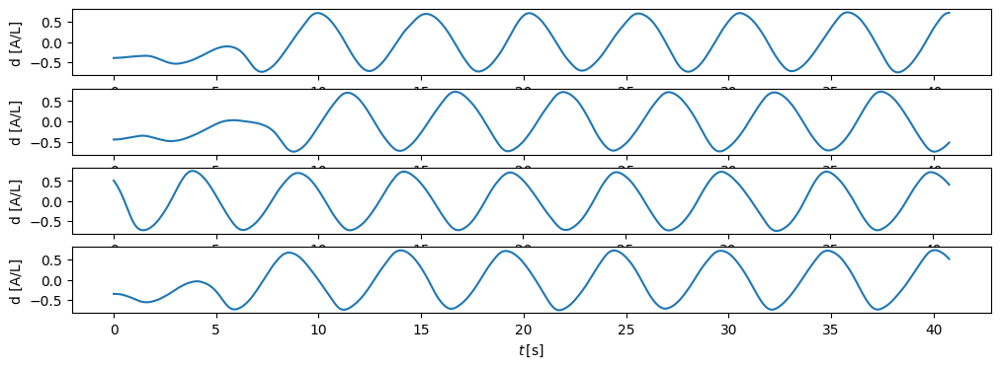

In [3]:
nTraj = 4
fig, axes = plt.subplots(nrows = nTraj, ncols = 1, figsize = (12,4))

for i in range(nTraj):
    axes[i].plot(xData[i][0].ravel(),
                 xData[i][1].ravel(),'-')
    axes[i].set_xlabel('$t \, [$s$]$')
    axes[i].set_ylabel('d [A/L]')



In [4]:

# selecting the training and test trajectories
indTrain = [*range(0, 16)]

indTest = [*range(16, 20)]


In [5]:
from ssmlearnpy import SSMLearn
import matplotlib.pyplot as plt


from ssmlearnpy.geometry.coordinates_embedding import coordinates_embedding
t_y, y, opts_embedding = coordinates_embedding([xData[i][0].ravel() for i in indTrain], [xData[i][1] for i in indTrain],
                                               imdim = 2, over_embedding = 20)

INFO   2025-02-28 23:44:08 coordinates_embedding The 25 embedding coordinates consist of the measured state and its 24 time-delayed measurements.


## Fitting the reduced-order model
The middle, undeflected position of the flag becomes unstable at a certain flow speed in a pitchfork bifurcation. At the same time, a stable limit cycle appears, which corresponds to a large amplitude flapping motion. 
The unstable fixed point is of saddle type. The transition towards the stable limit cycle thus takes places on the slow two-dimensional, mixed-mode SSM of the unstable fixed point. 
We now fit this SSM in the delay-embedded observable space. 

In [6]:
ssm = SSMLearn(
    t = t_y, 
    x = y, 
    derive_embdedding=False,
    ssm_dim=2, 
    dynamics_type = 'flow',
)

In [7]:
ssm.get_reduced_coordinates('linearchart')
ssm.get_parametrization()

INFO   2025-02-28 23:44:08 ridge Transforming data
INFO   2025-02-28 23:44:08 ridge Skipping CV on ridge regression
INFO   2025-02-28 23:44:08 ridge Fitting regression model


In [8]:
from ssmlearnpy.utils.plots import Plot

plotter = Plot(
    label_observables = 'y',
    label_reduced_coordinates = 'eta'
)

In [9]:
fig = plotter.make_plot(ssm, data_name = 'reduced_coordinates', idx_coordinates=[1, 2])
fig.show()

In [10]:
fig = plotter.make_plot(ssm, data_name = 'observables', idx_trajectories=[0, 1, 3, 4, 5], idx_coordinates=[0, 1, 2],
                        with_predictions = False, add_surface = True)
fig.show()

In [14]:
len(xData[0])

2

## Reduced-dynamics
Since the origin is of saddle-type, the linearized dynamics within the mixed-mode spectral subspace is characterized by a pair of real eigenvalues 
$$
\lambda_2 < 0 < \lambda_1
$$

and a pair of corresponding eigenvectors
$$
e_2, \text{ and } e_1.
$$

We do not carry out any normalization and hence the reduced dynamics is returned in modal form. 



In [185]:
ssm.get_reduced_dynamics(poly_degree = 11)

INFO   2024-09-11 14:48:48 ridge Transforming data
INFO   2024-09-11 14:48:48 ridge Skipping CV on ridge regression
INFO   2024-09-11 14:48:48 ridge Fitting regression model


In [186]:
ssm.predict()

In [187]:
fig = plotter.make_plot(
        ssm,
        t = ssm.emb_data['time'],
        x = ssm.emb_data['reduced_coordinates'],
        t_pred = ssm.emb_data['time'],
        x_pred = ssm.reduced_dynamics_predictions['reduced_coordinates'],
        with_predictions = True, idx_coordinates=[1, 2]
    )
fig.show()

## Drawing the reduced phase portrait

In [188]:
eta1 = np.linspace(-4, 4, 30)
eta2 = np.linspace(-1.2, 1.2, 30)
Eta1, Eta2 = np.meshgrid(eta1, eta2)


etaPlot = np.vstack((Eta1.ravel(), Eta2.ravel())).T

vectorfieldPlot = ssm.reduced_dynamics.predict(etaPlot).T
dEta1 = vectorfieldPlot[0,:].reshape(Eta1.shape)
dEta2 = vectorfieldPlot[1,:].reshape(Eta1.shape)


Text(0, 0.5, '$\\eta_2$')

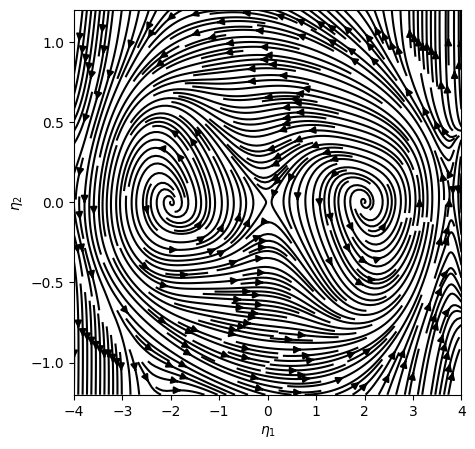

In [189]:
plt.figure(figsize = (5,5))
plt.streamplot(Eta1, Eta2, dEta1, dEta2, color='black', density = 3)
plt.xlabel('$\eta_1$')
plt.ylabel('$\eta_2$')


## Finding the fixed points and the limit cycle

The phase portrait above suggests a coexistence of three fixed points: a saddle at $\eta_1 = \eta_2 = 0$, and two repellors in symmetric configurations at $(\pm \eta_1^*, 0)$.

In [190]:
from scipy.optimize import root

In [191]:
vectorfield = lambda x: ssm.reduced_dynamics.predict(np.array(x).reshape(1,-1)
                                                    ).ravel()

In [192]:
x0_1 = root(vectorfield, [-1, 0])
x0_2 = root(vectorfield, [1, 0])

The eigenvectors of the saddle (origin) are in the ```reduced_dynamics.map_info``` dictionary.

In [193]:
w1 = ssm.reduced_dynamics.map_info['eigenvectors_linear_part'][:,0]
w2 = ssm.reduced_dynamics.map_info['eigenvectors_linear_part'][:,1]


Advect initial conditions along the stable and unstable subspaces 

In [194]:
from scipy.integrate import solve_ivp

In [195]:
vectorfield_to_integrate = lambda t, x: ssm.reduced_dynamics.predict(np.array(x).reshape(1,-1)
                                                    ).ravel()

In [196]:
ic_2 = 1e-4 * w2
ic_1 = 1e-4 * w1


In [197]:
unstable_manifold_1 = solve_ivp(vectorfield_to_integrate, [0, 100], ic_1,  t_eval= np.linspace(0, 100, 1000))
unstable_manifold_2 = solve_ivp(vectorfield_to_integrate, [0, 100],  -ic_1, t_eval= np.linspace(0, 100, 1000),)

In [198]:
stable_manifold_1 = solve_ivp(vectorfield_to_integrate, [0, -100], ic_2,  t_eval= np.linspace(0, -100, 1000))
stable_manifold_2 = solve_ivp(vectorfield_to_integrate, [0, -100],  -ic_2, t_eval= np.linspace(0, -100, 1000),)

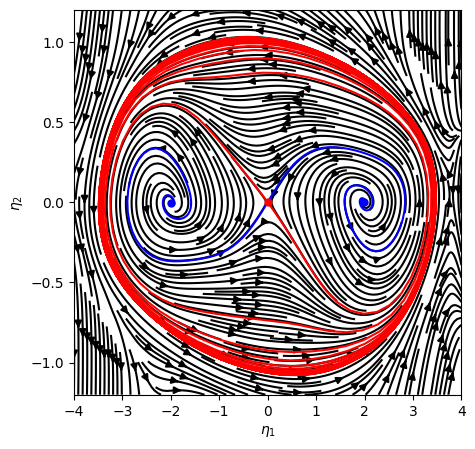

In [199]:
plt.figure(figsize = (5,5))

plt.streamplot(Eta1, Eta2, dEta1, dEta2, color='black', density = 3)
plt.xlabel('$\eta_1$')
plt.ylabel('$\eta_2$')



plt.plot(stable_manifold_1.y[0,:], stable_manifold_1.y[1,:], c= 'blue')
plt.plot(stable_manifold_2.y[0,:], stable_manifold_2.y[1,:], c= 'blue')

plt.plot(unstable_manifold_1.y[0,:], unstable_manifold_1.y[1,:], c= 'red')
plt.plot(unstable_manifold_2.y[0,:], unstable_manifold_2.y[1,:], c= 'red')

plt.plot(0,0, '.', markersize = 10, c='red')
plt.plot(*x0_1.x, '.', markersize = 10,  c='blue')
plt.plot(*x0_2.x, '.',  markersize = 10,  c='blue')